# Feature preperation for calcium predictive models

Connection to the data stored in the cloud

In [0]:
hadoop_config = spark._jsc.hadoopConfiguration()
hadoop_config.set("fs.azure.account.key.bovianalytics.blob.core.windows.net",
  "a3/QhTcHik/gwnSCI/eBdjK1GruaFdeELpSzdnwKAKe6LebTUz6Ca4cKwUUWFdWO2JmUAFdaq/N6VMc/OXLdPg==")

# Labels

In [0]:
CalvingData = spark \
  .read \
  .option("inferSchema","true") \
  .option("header","true") \
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Labels")

In [0]:
from pyspark.sql import functions as f

In [0]:
Calcium012 = CalvingData.filter((f.col('CalciumDaysInMilk') == 0) | (f.col('CalciumDaysInMilk') == 1) | (f.col('CalciumDaysInMilk') == 2))

# Features

In [0]:
display(dbutils.fs.ls("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Features"))

In [0]:
SensorData = spark \
.read \
.option("header","true") \
.csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Features/") 

In [0]:
dfFilteredSensorData = SensorData \
  .withColumn("TransitionDaysInMilk", SensorData.TransitionDaysInMilk.cast("integer")) \
  .filter(f.col("TransitionDaysInMilk").between(-22, -1))

In [0]:
dfFilteredSensorData2 = dfFilteredSensorData \
  .filter((dfFilteredSensorData.Sensor != 'EatingTimeMinutesPer15Minutes') & 
         (dfFilteredSensorData.Sensor != 'EatingTimeMinutesPer2Hours') &
         (dfFilteredSensorData.Sensor != 'InactiveTimeMinutesPer15Minutes') &
         (dfFilteredSensorData.Sensor != 'InactiveTimeMinutesPer2Hours') &
         (dfFilteredSensorData.Sensor != 'LegActivityStepsPer15Minutes') &
         (dfFilteredSensorData.Sensor != 'LegActivityStepsPer2Hours') &
         (dfFilteredSensorData.Sensor != 'LyingBoutLengthLowerQntMinutesPerDay') &
         (dfFilteredSensorData.Sensor != 'LyingBoutLengthMaxMinutesPerDay') &
         (dfFilteredSensorData.Sensor != 'LyingBoutLengthMedMinutesPerDay') &
         (dfFilteredSensorData.Sensor != 'LyingBoutLengthMinMinutesPerDay') & 
         (dfFilteredSensorData.Sensor != 'LyingBoutLengthUpperQntMinutesPerDay') &
         (dfFilteredSensorData.Sensor != 'LyingBoutsPer15Minutes') &
         (dfFilteredSensorData.Sensor != 'LyingTimeMinutesPer15Minutes') &
         (dfFilteredSensorData.Sensor != 'LyingTimeMinutesPer2Hours') &
         (dfFilteredSensorData.Sensor != 'RuminationTimeMinutesPer15Minutes') &
         (dfFilteredSensorData.Sensor != 'RuminationTimeMinutesPer2Hours') &
         (dfFilteredSensorData.Sensor != 'StandingTimeMinutesPer15Minutes') &
         (dfFilteredSensorData.Sensor != 'StandingTimeMinutesPer2Hours') & 
         (dfFilteredSensorData.Sensor != 'WalkingTimeMinutesPer15Minutes') &
         (dfFilteredSensorData.Sensor != 'WalkingTimeMinutesPer2Hours'))

#drop other unnecessary columns 
dfFilteredSensorData2 = dfFilteredSensorData2.drop('TransitionAnimalEartag','DaysInMilk','EventDate')

#Features and Labels combined

In [0]:
Joined_dataset = Calcium012 \
  .join(dfFilteredSensorData2, ["AnimalEartag", "HerdIdentifier", "CalvingDate", "Parity", "LactationNumber", "CalvingSeason"])

In [0]:
from pyspark.sql.functions import col
from pyspark.sql.types import IntegerType
Joined_dataset = Joined_dataset \
  .withColumn("SensorValue", \
              col("SensorValue") \
                .cast(IntegerType()))    
Joined_dataset = Joined_dataset \
  .withColumn("AvgSensorValue", \
              col("AvgSensorValue") \
                .cast(IntegerType())) 
Joined_dataset = Joined_dataset \
  .withColumn("SDSensorValue", \
              col("SDSensorValue") \
                .cast(IntegerType()))  
Joined_dataset.printSchema()
(Joined_dataset)

root
 |-- AnimalEartag: string (nullable = true)
 |-- HerdIdentifier: integer (nullable = true)
 |-- CalvingDate: timestamp (nullable = true)
 |-- Parity: string (nullable = true)
 |-- LactationNumber: integer (nullable = true)
 |-- CalvingSeason: string (nullable = true)
 |-- FirstLocomotionScoreDate: timestamp (nullable = true)
 |-- FirstLocomotionScore: double (nullable = true)
 |-- FirstLocomotionType: string (nullable = true)
 |-- FirstBCSDate: timestamp (nullable = true)
 |-- FirstBCSScore: double (nullable = true)
 |-- FirstBCSType: string (nullable = true)
 |-- DryOffDate: timestamp (nullable = true)
 |-- DryOffBCS: double (nullable = true)
 |-- CalciumDate: timestamp (nullable = true)
 |-- CalciumValue: double (nullable = true)
 |-- KetosisDateOne: timestamp (nullable = true)
 |-- KetosisValueOne: double (nullable = true)
 |-- KetosisDateTwo: timestamp (nullable = true)
 |-- KetosisValueTwo: double (nullable = true)
 |-- PaperRecordedCalvingDate: timestamp (nullable = true)
 |

##Histograms per feature

In [0]:
#extract each feature
WalkingTimeMinutesPerDay = Joined_dataset.filter((f.col('Sensor') == "WalkingTimeMinutesPerDay"))
EatingBoutLengthMinutesPerBout = Joined_dataset.filter((f.col('Sensor') == "EatingBoutLengthMinutesPerBout"))
EatingInterBoutLengthMinutes = Joined_dataset.filter((f.col('Sensor') == "EatingInterBoutLengthMinutes"))
EatingNumberOfBoutsPerDay = Joined_dataset.filter((f.col('Sensor') == "EatingNumberOfBoutsPerDay"))
EatingTimeMinutesPerDay = Joined_dataset.filter((f.col('Sensor') == "EatingTimeMinutesPerDay"))
InactiveBoutLengthMinutesPerDay = Joined_dataset.filter((f.col('Sensor') == "InactiveBoutLengthMinutesPerDay"))
InactiveBoutsPerDay = Joined_dataset.filter((f.col('Sensor') == "InactiveBoutsPerDay"))
InactiveInterboutLengthMinutesPerDay = Joined_dataset.filter((f.col('Sensor') == "InactiveInterboutLengthMinutesPerDay"))
InactiveTimeMinutesPerDay = Joined_dataset.filter((f.col('Sensor') == "InactiveTimeMinutesPerDay"))
LegActivityStepsPerDay = Joined_dataset.filter((f.col('Sensor') == "LegActivityStepsPerDay"))
LyingBoutLengthMinutesPerDay = Joined_dataset.filter((f.col('Sensor') == "LyingBoutLengthMinutesPerDay"))
LyingBoutsPerDay = Joined_dataset.filter((f.col('Sensor') == "LyingBoutsPerDay"))
LyingTimeMinutesPerDay = Joined_dataset.filter((f.col('Sensor') == "LyingTimeMinutesPerDay"))
RuminationBoutLengthMinutesPerBout = Joined_dataset.filter((f.col('Sensor') == "RuminationBoutLengthMinutesPerBout"))
RuminationInterBoutLengthMinutes = Joined_dataset.filter((f.col('Sensor') == "RuminationInterBoutLengthMinutes"))
RuminationNumberOfBoutsPerDay = Joined_dataset.filter((f.col('Sensor') == "RuminationNumberOfBoutsPerDay"))
RuminationTimeMinutesPerDay = Joined_dataset.filter((f.col('Sensor') == "RuminationTimeMinutesPerDay"))
StandingTimeMinutesPerDay = Joined_dataset.filter((f.col('Sensor') == "StandingTimeMinutesPerDay"))
StandupsPerDay = Joined_dataset.filter((f.col('Sensor') == "StandupsPerDay"))

In [0]:
display(WalkingTimeMinutesPerDay)

In [0]:
display(EatingBoutLengthMinutesPerBout)

AnimalEartag,HerdIdentifier,CalvingDate,Parity,LactationNumber,CalvingSeason,FirstLocomotionScoreDate,FirstLocomotionScore,FirstLocomotionType,FirstBCSDate,FirstBCSScore,FirstBCSType,DryOffDate,DryOffBCS,CalciumDate,CalciumValue,KetosisDateOne,KetosisValueOne,KetosisDateTwo,KetosisValueTwo,PaperRecordedCalvingDate,BCSEndDryMinusDryOff,DryPeriodLength,LocomotionDaysInMilk,BCSDaysInMilk,CalciumDaysInMilk,KetosisOneDaysInMilk,KetosisTwoDaysInMilk,AnimalIdentifier,SensorValue,TransitionDaysInMilk,AvgSensorValue,SDSensorValue,Year,Sensor
NL760304840,2514,2017-08-30T00:00:00.000+0000,3+,4,Summer,2017-08-10T00:00:00.000+0000,3.0,LocomotionScoreEndDryPeriod,2017-08-10T00:00:00.000+0000,3.5,BCSEndDryPeriod,2017-07-13T00:00:00.000+0000,3.0,2017-08-31T00:00:00.000+0000,1.09,2017-09-06T00:00:00.000+0000,1.4,2017-09-14T00:00:00.000+0000,1.2,2017-08-30T00:00:00.000+0000,0.5,48,-20,-20,1,7,15,484,30,-3,31,11,2017,EatingBoutLengthMinutesPerBout
NL843515594,3314,2017-07-12T00:00:00.000+0000,3+,3,Summer,2017-06-29T00:00:00.000+0000,4.0,LocomotionScoreEndDryPeriod,2017-06-29T00:00:00.000+0000,3.75,BCSEndDryPeriod,2017-06-29T00:00:00.000+0000,3.75,2017-07-13T00:00:00.000+0000,2.17,2017-07-20T00:00:00.000+0000,5.1,2017-07-27T00:00:00.000+0000,5.3,2017-07-12T00:00:00.000+0000,0.0,13,-13,-13,1,8,15,121,13,-9,31,11,2017,EatingBoutLengthMinutesPerBout
NL843515594,3314,2017-07-12T00:00:00.000+0000,3+,3,Summer,2017-06-29T00:00:00.000+0000,4.0,LocomotionScoreEndDryPeriod,2017-06-29T00:00:00.000+0000,3.75,BCSEndDryPeriod,2017-06-29T00:00:00.000+0000,3.75,2017-07-13T00:00:00.000+0000,2.17,2017-07-20T00:00:00.000+0000,5.1,2017-07-27T00:00:00.000+0000,5.3,2017-07-12T00:00:00.000+0000,0.0,13,-13,-13,1,8,15,121,21,-2,31,11,2017,EatingBoutLengthMinutesPerBout
NL841706204,2514,2017-12-22T00:00:00.000+0000,3+,4,Winter,2017-12-14T00:00:00.000+0000,5.0,LocomotionScoreEndDryPeriod,2017-12-14T00:00:00.000+0000,4.0,BCSEndDryPeriod,2016-11-25T00:00:00.000+0000,1.0,2017-12-24T00:00:00.000+0000,2.13,2017-12-28T00:00:00.000+0000,1.9,2018-01-04T00:00:00.000+0000,3.7,2017-12-23T00:00:00.000+0000,3.0,392,-8,-8,2,6,13,620,43,-20,31,11,2017,EatingBoutLengthMinutesPerBout
NL656707067,2514,2018-02-16T00:00:00.000+0000,3+,3,Winter,2018-01-25T00:00:00.000+0000,4.0,LocomotionScoreEndDryPeriod,2018-01-25T00:00:00.000+0000,3.0,BCSEndDryPeriod,2016-11-25T00:00:00.000+0000,2.0,2018-02-17T00:00:00.000+0000,2.02,2018-02-22T00:00:00.000+0000,0.7,2018-03-01T00:00:00.000+0000,1.0,2018-02-16T00:00:00.000+0000,1.0,448,-22,-22,1,6,13,706,18,-11,31,11,2018,EatingBoutLengthMinutesPerBout
NL841706002,2514,2017-08-30T00:00:00.000+0000,3+,4,Summer,2017-08-24T00:00:00.000+0000,2.0,LocomotionScoreEndDryPeriod,2017-08-24T00:00:00.000+0000,3.25,BCSEndDryPeriod,2017-08-03T00:00:00.000+0000,3.25,2017-09-01T00:00:00.000+0000,1.97,2017-09-06T00:00:00.000+0000,1.4,2017-09-14T00:00:00.000+0000,1.5,2017-09-01T00:00:00.000+0000,0.0,27,-6,-6,2,7,15,600,18,-15,31,11,2017,EatingBoutLengthMinutesPerBout
NL571782693,3314,2017-09-19T00:00:00.000+0000,3+,5,Autumn,2017-09-14T00:00:00.000+0000,4.0,LocomotionScoreEndDryPeriod,2017-09-14T00:00:00.000+0000,2.5,BCSEndDryPeriod,2017-08-10T00:00:00.000+0000,2.5,2017-09-21T00:00:00.000+0000,1.81,2017-09-28T00:00:00.000+0000,1.8,2017-10-05T00:00:00.000+0000,0.7,2017-09-19T00:00:00.000+0000,0.0,40,-5,-5,2,9,16,98,28,-17,31,11,2017,EatingBoutLengthMinutesPerBout
NL679607285,2514,2018-02-16T00:00:00.000+0000,3+,3,Winter,2018-02-01T00:00:00.000+0000,4.0,LocomotionScoreEndDryPeriod,2018-02-01T00:00:00.000+0000,3.25,BCSEndDryPeriod,2017-01-26T00:00:00.000+0000,2.75,2018-02-17T00:00:00.000+0000,1.96,2018-02-22T00:00:00.000+0000,2.8,2018-03-01T00:00:00.000+0000,2.9,2018-02-17T00:00:00.000+0000,0.5,386,-15,-15,1,6,13,728,55,-22,31,11,2018,EatingBoutLengthMinutesPerBout
NL679607292,2514,2017-08-29T00:00:00.000+0000,2,2,Summer,2017-08-17T00:00:00.000+0000,4.0,LocomotionScoreEndDryPeriod,2017-08-17T00:00:00.000+0000,3.0,BCSEndDryPeriod,2017-07-27T00:00:00.000+0000,3.25,2017-08-30T00:00:00

In [0]:
display(EatingInterBoutLengthMinutes)

In [0]:
display(EatingNumberOfBoutsPerDay)

In [0]:
display(EatingTimeMinutesPerDay)

In [0]:
display(InactiveBoutLengthMinutesPerDay)

In [0]:
display(InactiveBoutsPerDay)

In [0]:
display(InactiveInterboutLengthMinutesPerDay)

In [0]:
display(InactiveTimeMinutesPerDay)

In [0]:
display(LegActivityStepsPerDay)

In [0]:
display(LyingBoutLengthMinutesPerDay)

In [0]:
display(LyingBoutsPerDay)

In [0]:
display(LyingTimeMinutesPerDay)

In [0]:
display(RuminationTimeMinutesPerDay)

In [0]:
display(RuminationBoutLengthMinutesPerBout)

In [0]:
display(RuminationInterBoutLengthMinutes)

In [0]:
display(RuminationNumberOfBoutsPerDay)

In [0]:
display(StandingTimeMinutesPerDay)

In [0]:
display(StandupsPerDay)

##Each feature gets its own column

In [0]:
pivotJoined_dataset = Joined_dataset \
  .groupBy(["AnimalEartag", "HerdIdentifier", "CalvingDate", "Parity", "LactationNumber", "CalvingSeason", "FirstLocomotionScoreDate", "FirstLocomotionScore", "FirstLocomotionType", "FirstBCSDate", "FirstBCSScore", "FirstBCSType", "DryOffDate", "DryOffBCS", "CalciumDate", "CalciumValue", "KetosisDateOne", "KetosisValueOne", "KetosisDateTwo", "KetosisValueTwo", "PaperRecordedCalvingDate", "BCSEndDryMinusDryOff", "DryPeriodLength", "LocomotionDaysInMilk", "BCSDaysInMilk", "CalciumDaysInMilk", "KetosisOneDaysInMilk", "KetosisTwoDaysInMilk", "AnimalIdentifier", "Year" , "TransitionDaysInMilk"]) \
  .pivot("Sensor", ["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay" ]) \
  .sum('SensorValue')
#remove AVG and SD, not needed

#Tussentijds opgeslagen set

In [0]:
pivotJoined_dataset\
  .repartition(1)\
  .write\
  .mode('overwrite') \
  .option("header","true")\
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/pivotJoined")

In [0]:
pivotJoined_dataset = spark \
  .read \
  .option('inferschema', 'true') \
  .option("header","true") \
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/pivotJoined")

In [0]:
#sort on animal per day 
pivotJoined_dataset = pivotJoined_dataset.sort(['AnimalEartag', 'CalvingDate', 'TransitionDaysInMilk'])

In [0]:
#cow recieved calcium infusion just before bloodsampling 
pivotJoined_dataset = pivotJoined_dataset \
  .filter(pivotJoined_dataset.CalciumValue < 3.4)

In [0]:
df2 = pivotJoined_dataset.groupBy(["AnimalEartag","PaperRecordedCalvingDate"]).count()
display(df2)


In [0]:
#graph of calcium distribution
display(pivotJoined_dataset)

In [0]:
from pyspark.sql.functions import col
from pyspark.sql.types import IntegerType
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("WalkingTimeMinutesPerDay", \
              col("WalkingTimeMinutesPerDay") \
                .cast(IntegerType()))    
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("EatingBoutLengthMinutesPerBout", \
              col("EatingBoutLengthMinutesPerBout") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("EatingInterBoutLengthMinutes", \
              col("EatingInterBoutLengthMinutes") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("EatingNumberOfBoutsPerDay", \
              col("EatingNumberOfBoutsPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("EatingTimeMinutesPerDay", \
              col("EatingTimeMinutesPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("InactiveBoutLengthMinutesPerDay", \
              col("InactiveBoutLengthMinutesPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("InactiveBoutsPerDay", \
              col("InactiveBoutsPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("InactiveInterboutLengthMinutesPerDay", \
              col("InactiveInterboutLengthMinutesPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("InactiveTimeMinutesPerDay", \
              col("InactiveTimeMinutesPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("LegActivityStepsPerDay", \
              col("LegActivityStepsPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("LyingBoutLengthMinutesPerDay", \
              col("LyingBoutLengthMinutesPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("LyingBoutsPerDay", \
              col("LyingBoutsPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("LyingTimeMinutesPerDay", \
              col("LyingTimeMinutesPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("RuminationBoutLengthMinutesPerBout", \
              col("RuminationBoutLengthMinutesPerBout") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("RuminationInterBoutLengthMinutes", \
              col("RuminationInterBoutLengthMinutes") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("RuminationNumberOfBoutsPerDay", \
              col("RuminationNumberOfBoutsPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("RuminationTimeMinutesPerDay", \
              col("RuminationTimeMinutesPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("StandingTimeMinutesPerDay", \
              col("StandingTimeMinutesPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset = pivotJoined_dataset \
  .withColumn("StandupsPerDay", \
              col("StandupsPerDay") \
                .cast(IntegerType())) 
pivotJoined_dataset.printSchema()

root
 |-- AnimalEartag: string (nullable = true)
 |-- HerdIdentifier: integer (nullable = true)
 |-- CalvingDate: timestamp (nullable = true)
 |-- Parity: string (nullable = true)
 |-- LactationNumber: integer (nullable = true)
 |-- CalvingSeason: string (nullable = true)
 |-- FirstLocomotionScoreDate: timestamp (nullable = true)
 |-- FirstLocomotionScore: double (nullable = true)
 |-- FirstLocomotionType: string (nullable = true)
 |-- FirstBCSDate: timestamp (nullable = true)
 |-- FirstBCSScore: double (nullable = true)
 |-- FirstBCSType: string (nullable = true)
 |-- DryOffDate: timestamp (nullable = true)
 |-- DryOffBCS: double (nullable = true)
 |-- CalciumDate: timestamp (nullable = true)
 |-- CalciumValue: double (nullable = true)
 |-- KetosisDateOne: timestamp (nullable = true)
 |-- KetosisValueOne: double (nullable = true)
 |-- KetosisDateTwo: timestamp (nullable = true)
 |-- KetosisValueTwo: double (nullable = true)
 |-- PaperRecordedCalvingDate: timestamp (nullable = true)
 |

#Scattermatrix

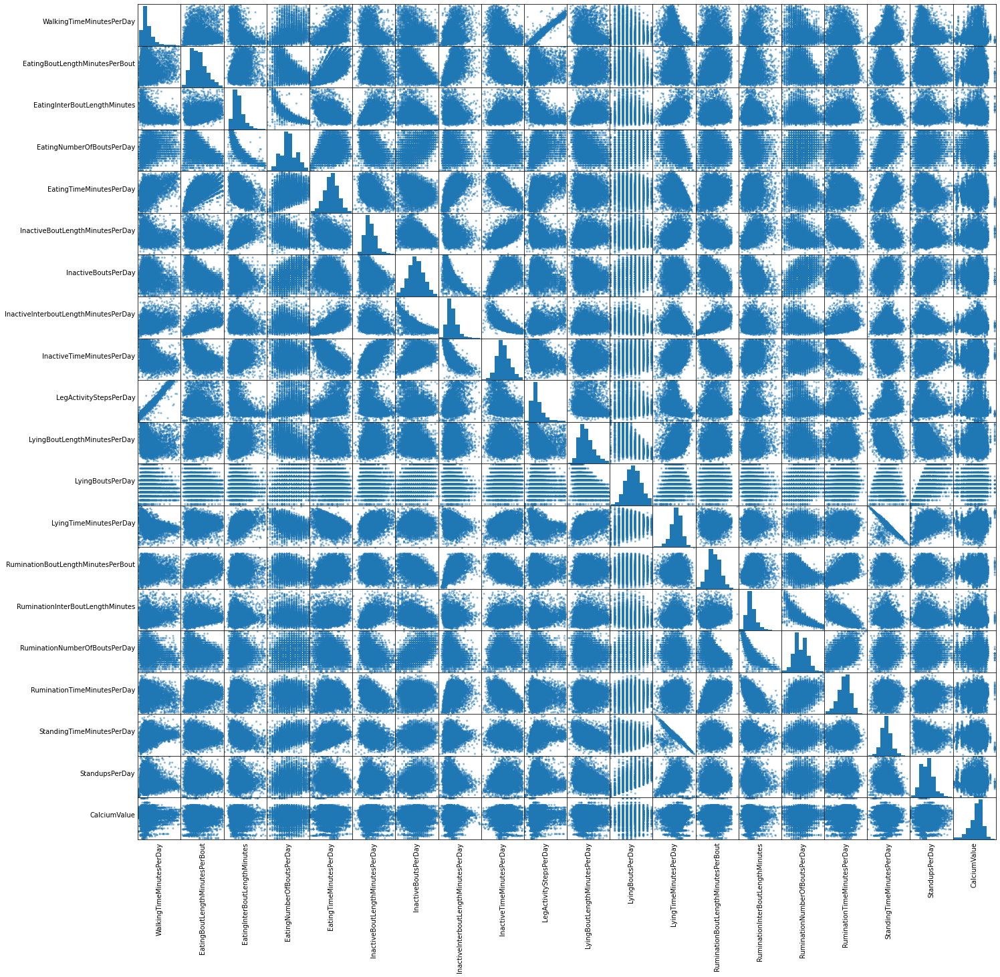

In [0]:
from pandas.plotting import scatter_matrix
Variables_for_scatter = ["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay", "CalciumValue"]

numeric_data = pivotJoined_dataset.select(Variables_for_scatter).toPandas()
axs = scatter_matrix(numeric_data, figsize=(23, 23));

# Rotate axis labels and remove axis ticks
n = len(numeric_data.columns)
for i in range(n):
    v = axs[i, 0]
    v.yaxis.label.set_rotation(0)
    v.yaxis.label.set_ha('right')
    v.set_yticks(())
    h = axs[n-1, i]
    h.xaxis.label.set_rotation(90)
    h.set_xticks(())

#Add calciumclusters

In [0]:
#Convert pyspark to R
pivotJoined_dataset.createOrReplaceTempView("R_scaled")

In [0]:
%r
require(SparkR)
Data_set_r <- sql("select * from R_scaled")
Data_set_r <- as.data.frame(Data_set_r)
head(Data_set_r)

In [0]:
%r
#lineair mixed effect model, built in order to compensate for dependencies in the data > farm, parity, day of sampling 
install.packages("lme4")
install.packages("ggplot2")
library(ggplot2)
library(lme4)
library(dplyr)
AnalysisDataCluster <- Data_set_r %>% 
dplyr::select(
    CalciumValue,
    CalciumDaysInMilk,
    Parity,
    AnimalEartag,
    HerdIdentifier)

#define model
ClusterLMER<-lme4::lmer(
                  CalciumValue ~ CalciumDaysInMilk * Parity +  (1| HerdIdentifier), 
                  data = AnalysisDataCluster,
                  REML = FALSE
                  )

#predict calcium
AnalysisDataCluster$PredictCalcium <- predict(ClusterLMER, newdata = AnalysisDataCluster)
AnalysisDataCluster$CalciumResidual <- residuals(ClusterLMER)
#k-means clustering
AnalysisDataCluster$CalciumCluster <- as.factor(kmeans(AnalysisDataCluster[,c("CalciumValue","CalciumResidual")],centers=2)$cluster)
#plot calcium vs residuals with clustering 
ggplot(AnalysisDataCluster,
aes(x=CalciumValue, y=CalciumResidual, colour = CalciumCluster))  +
geom_point() +
scale_color_manual(breaks = c('1','2'),
                   values=c("gray20", "gray89")) +
theme_classic()

In [0]:
%r
#when numbers of observations are limited, a binary variable is easier to predict. Therefore the clustering is used as a binary variable
Calciumcluster <- AnalysisDataCluster$CalciumCluster 
#add clusters to dataframe
data_set_r2 <- cbind(Data_set_r, Calciumcluster)
#change name of cluster 2 to 0 not at risk and 1 stays 1 at risk of hypocalceamia
levels(data_set_r2$Calciumcluster) <- c(1,0)
summary(data_set_r2$Calciumcluster)

In [0]:
%r
#convert dataframe from r back to python 
data_set_levels <- as.DataFrame(data_set_r2)

createOrReplaceTempView(data_set_levels,"r_back_to_py")

In [0]:
Data_set_from_r = sql("SELECT * FROM r_back_to_py") 

#tussentijds opgeslagen set met calciumclusters

In [0]:
Data_set_from_r\
  .repartition(1)\
  .write\
  .option("header","true")\
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/metcluster")

In [0]:
Data_set_from_r = spark \
  .read \
  .option('inferschema', 'true') \
  .option("header","true") \
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/metcluster")

#Add missing rows

In [0]:
panda_data_set = Data_set_from_r.toPandas()
#convert pyspark dataframe to panda dataframe

In [0]:
#I wanted to know the sizes of the herds
filter = panda_data_set.groupby(['AnimalEartag', 'PaperRecordedCalvingDate']).first()
filter['HerdIdentifier'].value_counts()
# display(filter)

Out[3]: 5888    122
2746    120
2011     88
2514     83
544      75
2297     59
3        33
3314     29
Name: HerdIdentifier, dtype: int64

In [0]:
#Only keep scores for the end of dry period, because scores from different time points are incomparable 
panda_data_set['FirstLocomotionScore'].mask(panda_data_set['FirstLocomotionType'] != 'LocomotionScoreEndDryPeriod', 0, inplace=True)
panda_data_set['FirstBCSScore'].mask(panda_data_set['FirstBCSType'] != 'BCSEndDryPeriod', 0, inplace=True)

In [0]:
import pandas as pd
#extract unique cows and the static features that belong to that cow and are never missing 
unique_calvings = panda_data_set[['AnimalEartag', 'PaperRecordedCalvingDate']].drop_duplicates() 
Cluster_lijst = []
CalciumValue_lijst = []
season_lijst = []
calindays_lijst = []
parity_lijst = []
HerdIdentifier_lijst = []

#filter through dataset 
for index, (AnimalEartag, PaperRecordedCalvingDate) in unique_calvings.iterrows():
    filter1 = panda_data_set['AnimalEartag'] == AnimalEartag
    filter2 = PaperRecordedCalvingDate == panda_data_set['PaperRecordedCalvingDate']
    gefilterde_set = panda_data_set[filter1 & filter2]
    Parity = gefilterde_set['Parity'].iloc[-1]
    HerdIdentfier = gefilterde_set['HerdIdentifier'].iloc[-1]
    Calindays = gefilterde_set['CalciumDaysInMilk'].iloc[-1]
    season = gefilterde_set['CalvingSeason'].iloc[-1] 
    Calcium_cluster = gefilterde_set['Calciumcluster'].iloc[-1]
    Calcium_Value = gefilterde_set['CalciumValue'].iloc[-1]
    Cluster_lijst.append((Calcium_cluster)) 
    CalciumValue_lijst.append((Calcium_Value))
    season_lijst.append((season))
    calindays_lijst.append(Calindays)
    parity_lijst.append(Parity)
    HerdIdentifier_lijst.append(HerdIdentfier)
#add to list and dataframe    
Calcium_df = pd.DataFrame (Cluster_lijst, columns = ['Calciumcluster'])  
Calcium_df['CalciumValue'] = CalciumValue_lijst
Calcium_df['CalvingSeason'] = season_lijst
Calcium_df['Parity'] = parity_lijst
Calcium_df['CalciumDaysInMilk'] = calindays_lijst
Calcium_df['HerdIdentifier'] = HerdIdentifier_lijst


In [0]:
#Some cows had two rows for the same day, solved by group-by
data_set_bijna_compleet = panda_data_set.groupby(['AnimalEartag','PaperRecordedCalvingDate','TransitionDaysInMilk'], as_index = False) \
.sum(["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay"])
#groupby caused columns to go missing, re-added by a left merge with the old dataframe 
data_set_bijna_compleet = pd.merge(data_set_bijna_compleet, panda_data_set, on = ['AnimalEartag', 'PaperRecordedCalvingDate', 'TransitionDaysInMilk', "WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay", "HerdIdentifier", "LactationNumber", "FirstLocomotionScore", 'FirstBCSScore', 'DryOffBCS', 'CalciumValue', 'KetosisValueOne', 'KetosisValueTwo', 'BCSEndDryMinusDryOff', 'DryPeriodLength', 'LocomotionDaysInMilk', 'BCSDaysInMilk', 'CalciumDaysInMilk', 'KetosisOneDaysInMilk', 'KetosisTwoDaysInMilk', "Year", "AnimalIdentifier"], how = 'left')

In [0]:
#extract BCS and Loco scores
grouped_set = panda_data_set.groupby(['AnimalEartag', 'PaperRecordedCalvingDate']).max(['FirstBCSScore', 'FirstLocomotionScore'])
BCSandLoco = grouped_set[['FirstBCSScore', 'FirstLocomotionScore']]

In [0]:
#insert rows, every cow must have 22 rows and 19 features 
import pandas as pd
import numpy as np
unique_calvings = data_set_bijna_compleet[['AnimalEartag', 'PaperRecordedCalvingDate']].drop_duplicates() #609 unique cows
unique_calvings.reset_index(drop=True, inplace=True)
Calcium_df.reset_index(drop=True, inplace=True)
BCSandLoco.reset_index(drop = True, inplace = True)

columns_to_transform = ["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay"]

new_column = [*range(-21,1)]

unique_calvings['TransitionDaysInMilk'] = pd.Series([new_column for x in range(len(unique_calvings.index))]).values
unique_calvings = unique_calvings.join(Calcium_df, how = 'left')
unique_calvings_clus = unique_calvings.join(BCSandLoco, how = 'left')
right_df = unique_calvings_clus.groupby(['AnimalEartag', 'PaperRecordedCalvingDate','Calciumcluster', 'CalciumValue', 'CalvingSeason', 'CalciumDaysInMilk', 'Parity', 'FirstBCSScore', 'FirstLocomotionScore', 'HerdIdentifier']).TransitionDaysInMilk.apply(lambda x: pd.DataFrame(x.values[0])).reset_index()
right_df = right_df.drop('level_10', axis=1)
right_df.columns = ['AnimalEartag', 'PaperRecordedCalvingDate', 'Calciumcluster', 'CalciumValue', 'CalvingSeason', 'CalciumDaysInMilk', 'Parity', 'FirstBCSScore', 'FirstLocomotionScore', 'HerdIdentifier', 'TransitionDaysInMilk']
panda_set_compleet = pd.merge(right_df, data_set_bijna_compleet, on = ['AnimalEartag', 'PaperRecordedCalvingDate',  'TransitionDaysInMilk'], how = 'left')
panda_set_compleet['Calciumcluster'] = right_df['Calciumcluster']
panda_set_compleet['CalciumValue'] = right_df['CalciumValue']
panda_set_compleet['CalvingSeason'] = right_df['CalvingSeason']
panda_set_compleet['Parity'] = right_df['Parity']
panda_set_compleet['CalciumDaysInMilk'] = right_df['CalciumDaysInMilk']
panda_set_compleet['FirstLocomotionScore'] = right_df['FirstLocomotionScore']
panda_set_compleet['FirstBCSScore'] = right_df['FirstBCSScore']
panda_set_compleet['HerdIdentifier'] = right_df['HerdIdentifier']
panda_set_compleet = panda_set_compleet.drop(['Calciumcluster_y', 'Calciumcluster_x', 'CalciumValue_x', 'CalciumValue_y', 'CalvingSeason_x', 'CalvingSeason_y', 'CalciumDaysInMilk_x', 'CalciumDaysInMilk_y', 'Parity_x', 'Parity_y', 'FirstLocomotionScore_x', 'FirstLocomotionScore_y', 'FirstBCSScore_x', 'FirstBCSScore_y', 'HerdIdentifier_x', 'HerdIdentifier_y'], axis =1)
panda_set_compleet[columns_to_transform] = panda_set_compleet[columns_to_transform].replace(0, np.nan) #zodat 0 null wordt
display(panda_set_compleet)

AnimalEartag,PaperRecordedCalvingDate,Calciumcluster,TransitionDaysInMilk,LactationNumber,DryOffBCS,KetosisValueOne,KetosisValueTwo,BCSEndDryMinusDryOff,DryPeriodLength,LocomotionDaysInMilk,BCSDaysInMilk,KetosisOneDaysInMilk,KetosisTwoDaysInMilk,AnimalIdentifier,Year,WalkingTimeMinutesPerDay,EatingBoutLengthMinutesPerBout,EatingInterBoutLengthMinutes,EatingNumberOfBoutsPerDay,EatingTimeMinutesPerDay,InactiveBoutLengthMinutesPerDay,InactiveBoutsPerDay,InactiveInterboutLengthMinutesPerDay,InactiveTimeMinutesPerDay,LegActivityStepsPerDay,LyingBoutLengthMinutesPerDay,LyingBoutsPerDay,LyingTimeMinutesPerDay,RuminationBoutLengthMinutesPerBout,RuminationInterBoutLengthMinutes,RuminationNumberOfBoutsPerDay,RuminationTimeMinutesPerDay,StandingTimeMinutesPerDay,StandupsPerDay,CalvingDate,FirstLocomotionScoreDate,FirstLocomotionType,FirstBCSDate,FirstBCSType,DryOffDate,CalciumDate,KetosisDateOne,KetosisDateTwo,CalciumValue,CalvingSeason,Parity,CalciumDaysInMilk,FirstLocomotionScore,FirstBCSScore,HerdIdentifier
NL340704985,2017-05-21T00:00:00.000+0000,0,-21,13.0,2.0,2.0,4.2,0.25,33.0,-5.0,-5.0,9.0,16.0,9.0,2017.0,25.0,15.0,129.0,10.0,159.0,32.0,23.0,28.0,746.0,2852.0,120.0,6.0,736.0,31.0,58.0,16.0,535.0,679.0,9.0,2017-05-21T00:00:00.000+0000,2017-05-16T00:00:00.000+0000,LocomotionScoreEndDryPeriod,2017-05-16T00:00:00.000+0000,BCSEndDryPeriod,2017-04-18T00:00:00.000+0000,2017-05-23T00:00:00.000+0000,2017-05-30T00:00:00.000+0000,2017-06-06T00:00:00.000+0000,2.23,Spring,3+,2,4.0,2.25,2297
NL340704985,2017-05-21T00:00:00.000+0000,0,-20,13.0,2.0,2.0,4.2,0.25,33.0,-5.0,-5.0,9.0,16.0,9.0,2017.0,27.0,17.0,123.0,11.0,190.0,40.0,19.0,33.0,778.0,2907.0,124.0,6.0,714.0,33.0,65.0,14.0,472.0,699.0,6.0,2017-05-21T00:00:00.000+0000,2017-05-16T00:00:00.000+0000,LocomotionScoreEndDryPeriod,2017-05-16T00:00:00.000+0000,BCSEndDryPeriod,2017-04-18T00:00:00.000+0000,2017-05-23T00:00:00.000+0000,2017-05-30T00:00:00.000+0000,2017-06-06T00:00:00.000+0000,2.23,Spring,3+,2,4.0,2.25,2297
NL340704985,2017-05-21T00:00:00.000+0000,0,-19,13.0,2.0,2.0,4.2,0.25,33.0,-5.0,-5.0,9.0,16.0,9.0,2017.0,53.0,16.0,98.0,12.0,208.0,30.0,23.0,29.0,716.0,5076.0,105.0,5.0,566.0,28.0,55.0,18.0,499.0,821.0,8.0,2017-05-21T00:00:00.000+0000,2017-05-16T00:00:00.000+0000,LocomotionScoreEndDryPeriod,2017-05-16T00:00:00.000+0000,BCSEndDryPeriod,2017-04-18T00:00:00.000+0000,2017-05-23T00:00:00.000+0000,2017-05-30T00:00:00.000+0000,2017-06-06T00:00:00.000+0000,2.23,Spring,3+,2,4.0,2.25,2297
NL340704985,2017-05-21T00:00:00.000+0000,0,-18,13.0,2.0,2.0,4.2,0.25,33.0,-5.0,-5.0,9.0,16.0,9.0,2017.0,30.0,19.0,147.0,8.0,158.0,37.0,22.0,28.0,821.0,3286.0,129.0,5.0,657.0,33.0,73.0,13.0,461.0,753.0,6.0,2017-05-21T00:00:00.000+0000,2017-05-16T00:00:00.000+0000,LocomotionScoreEndDryPeriod,2017-05-16T00:00:00.000+0000,BCSEndDryPeriod,2017-04-18T00:00:00.000+0000,2017-05-23T00:00:00.000+0000,2017-05-30T00:00:00.000+0000,2017-06-06T00:00:00.000+0000,2.23,Spring,3+,2,4.0,2.25,2297
NL340704985,2017-05-21T00:00:00.000+0000,0,-17,13.0,2.0,2.0,4.2,0.25,33.0,-5.0,-5.0,9.0,16.0,9.0,2017.0,30.0,15.0,177.0,8.0,130.0,42.0,18.0,33.0,775.0,2878.0,82.0,10.0,741.0,39.0,67.0,14.0,535.0,669.0,10.0,2017-05-21T00:00:00.000+0000,2017-05-16T00:00:00.000+0000,LocomotionScoreEndDryPeriod,2017-05-16T00:00:00.000+0000,BCSEndDryPeriod,2017-04-18T00:00:00.000+0000,2017-05-23T00:00:00.000+0000,2017-05-30T00:00:00.000+0000,2017-06-06T00:00:00.000+0000,2.23,Spring,3+,2,4.0,2.25,2297
NL340704985,2017-05-21T00:00:00.000+0000,0,-16,13.0,2.0,2.0,4.2,0.25,33.0,-5.0,-5.0,9.0,16.0,9.0,2017.0,27.0,17.0,170.0,8.0,149.0,37.0,20.0,36.0,744.0,2991.0,95.0,6.0,648.0,34.0,56.0,15.0,547.0,765.0,7.0,2017-05-21T00:00:00.000+0000,2017-05-16T00:00:00.000+0000,LocomotionScoreEndDryPeriod,2017-05-16T00:00:00.000+0000,BCSEndDryPeriod,2017-04-18T00:00:00.000+0000,2017-05-23T00:00:00.000+0000,2017-05-30T00:00:00.000+0000,2017-06-06T00:00:00.000+0000,2.23,Spring,3+,2,4.0,2.25,2297
NL340704985,2017-05-21T00:00:00.000+0000,0,-15,13.0,2.0,2.0,4.2,0.25,33.0,-5.0,-5.0,9

In [0]:
#add column with cut-off value #cut-off value based on: Prevalence of subclinical hypocalcemia in dairy herds by Reinhardt
panda_set_compleet['Cut_Off'] = np.where(panda_set_compleet['CalciumValue']<= 2.0, '1', '0')


In [0]:
#drop 0 
panda_set_compleet = panda_set_compleet[panda_set_compleet.TransitionDaysInMilk !=0]


In [0]:
#simplified version of the dataset to make into an ontology for open sourcing data. Contains only data used for analysis plus herd
set_for_ontology = panda_set_compleet[['AnimalEartag','PaperRecordedCalvingDate', "TransitionDaysInMilk", "HerdIdentifier", 'Parity', 'CalciumDaysInMilk', 'Cut_Off', 'CalvingSeason', 'Calciumcluster', 'CalciumValue', 'FirstLocomotionScore', 'FirstBCSScore', "WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay"]]
display(set_for_ontology)
set_for_ontology_spark = spark.createDataFrame(set_for_ontology)

#Extra saved set for export to csv ontology

In [0]:
#extra saving for export to csv 
set_for_ontology_spark\
  .repartition(1)\
  .write\
  .mode('overwrite') \
  .option("header","true")\
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/forontology")

In [0]:
b = panda_set_compleet[['AnimalEartag','PaperRecordedCalvingDate',"WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay"]]
test_op_all_na = b.groupby(['AnimalEartag', 'PaperRecordedCalvingDate']).sum(columns_to_transform)
import numpy as np
# test_op_all_na = test_op_all_na[columns_to_transform]
test_op_all_na = test_op_all_na.replace(0, np.nan)
test_op_all_na = test_op_all_na.dropna(thresh=1, axis=0)
#test_op_all_na = test_op_all_na.replace(np.nan, 0)
test_op_all_na = test_op_all_na.reset_index()
# selectiekolommen = test_op_all_na.loc[:,['AnimalEartag','PaperRecordedCalvingDate']]
# selectiekolommen
test_op_all_na

#Devide train, test and validation set

In [0]:
#random shuffeling otherwise the cows are ordered chronological which causes bias
np.random.seed(89)
grouped = panda_set_compleet.groupby(['AnimalEartag', 'PaperRecordedCalvingDate'])
a=np.arange(grouped.ngroups)
np.random.shuffle(a)
panda_set_shuffeld = panda_set_compleet[grouped.ngroup().isin(a[:])]

In [0]:
#We cannot use random way of splitting dataset into train and test as
#the sequence of events is important for time series.
#So let us take first 60% values = 365 koeien van de 609 for train and the remaining 40% for testing and validation 122 koeien each 
# split into train and test sets
train_size = 365*22
test_size = 122*22+365*22
validation_size = 122*22
train_set, test_set, validation_set = panda_set_shuffeld.iloc[0:train_size,:], panda_set_shuffeld.iloc[train_size:test_size,:], panda_set_shuffeld.iloc[test_size:len(panda_set_shuffeld),:]

In [0]:
train_set

,AnimalEartag,PaperRecordedCalvingDate,Calciumcluster,TransitionDaysInMilk,LactationNumber,DryOffBCS,KetosisValueOne,KetosisValueTwo,BCSEndDryMinusDryOff,DryPeriodLength,...,KetosisDateOne,KetosisDateTwo,CalciumValue,CalvingSeason,Parity,CalciumDaysInMilk,FirstLocomotionScore,FirstBCSScore,HerdIdentifier,Cut_Off
0,NL340704985,2017-05-21,0,-21,13.0,2.0,2.0,4.2,0.25,33.0,...,2017-05-30,2017-06-06,2.23,Spring,3+,2,4.0,2.25,2297,0
1,NL340704985,2017-05-21,0,-20,13.0,2.0,2.0,4.2,0.25,33.0,...,2017-05-30,2017-06-06,2.23,Spring,3+,2,4.0,2.25,2297,0
2,NL340704985,2017-05-21,0,-19,13.0,2.0,2.0,4.2,0.25,33.0,...,2017-05-30,2017-06-06,2.23,Spring,3+,2,4.0,2.25,2297,0
3,NL340704985,2017-05-21,0,-18,13.0,2.0,2.0,4.2,0.25,33.0,...,2017-05-30,2017-06-06,2.23,Spring,3+,2,4.0,2.25,2297,0
4,NL340704985,2017-05-21,0,-17,13.0,2.0,2.0,4.2,0.25,33.0,...,2017-05-30,2017-06-06,2.23,Spring,3+,2,4.0,2.25,2297,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8407,NL878010877,2018-03-12,0,-18,4.0,0.0,1.8,2.4,0.00,0.0,...,NaT,NaT,2.20,Spring,3+,1,0.0,0.00,5888,0
8408,NL878010877,2018-03-12,0,-17,4.0,0.0,1.8,2.4,0.00,0.0,...,NaT,NaT,2.20,Spring,3+,1,0.0,0.00,5888,0
8409,NL878010877,2018-03-12,0,-16,4.0,0.0,1.8,2.4,0.00,0.0,...,NaT,NaT,2.20,Spring,3+,1,0.0,0.00,5888,0
8410,NL878010877,2018-03-12,0,-15,4.0,0.0,1.8,2.4,0.00,0.0,...,NaT,NaT,2.20,Spring,3+,1,0.0,0.00,5888,0


#Normalise sensor data

In [0]:
columns_to_select = ["TransitionDaysInMilk", "WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay"]

def norm_to_zero_one(df):
     return (df - df.min()) * 1.0 / (df.max() - df.min())
  
transdays = train_set["TransitionDaysInMilk"]

train_set[columns_to_select] = train_set[columns_to_select].apply(norm_to_zero_one)
train_set["TransitionDaysInMilk"] = transdays

#also for test and validation 
transdays_test = test_set["TransitionDaysInMilk"]
test_set[columns_to_select] = test_set[columns_to_select].apply(norm_to_zero_one)
test_set["TransitionDaysInMilk"] = transdays_test

transdays_validatie = validation_set["TransitionDaysInMilk"]
validation_set[columns_to_select] = validation_set[columns_to_select].apply(norm_to_zero_one)
validation_set["TransitionDaysInMilk"] = transdays_validatie



<command-3736422397734641>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_set[columns_to_select] = train_set[columns_to_select].apply(norm_to_zero_one)
<command-3736422397734641>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_set["TransitionDaysInMilk"] = transdays
<command-3736422397734641>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

In [0]:
import numpy as np
import pandas as pd
#alleen unieke combinaties van die en kalfmoment 
Unique_Calvings = train_set[['AnimalEartag', 'PaperRecordedCalvingDate']].drop_duplicates() 

#defitie van de sensoren
feature_names =["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay"]

AnimalEartag_list = []
PaperRecordedCalvingDate_list = []
SensorWaardes_list = np.zeros((365,22,19))
j = 0
for index, (AnimalEartag, PaperRecordedCalvingDate) in Unique_Calvings.iterrows():
    filter1 = train_set['AnimalEartag'] == AnimalEartag
    filter2 = PaperRecordedCalvingDate == train_set['PaperRecordedCalvingDate']
    df_calving = train_set[filter1 & filter2]
 
    sw = df_calving[feature_names]
  
  #convert to numpy
    sw_numpy = np.array(sw)
    #add to list 
    AnimalEartag_list.append(AnimalEartag)
    PaperRecordedCalvingDate_list.append(PaperRecordedCalvingDate)
  
    SensorWaardes_list[j] = sw_numpy
    j = j + 1

x_train_not_imputed = np.array(SensorWaardes_list)
np.save("/tmp/x-train",x_train_not_imputed)

In [0]:
dbutils.fs.cp("file:/tmp/x-train.npy","dbfs:/FileStore/shared_uploads/m.b.vanleerdam@students.uu.nl/data/x-train.npy")

https://community.cloud.databricks.com/files/shared_uploads/m.b.vanleerdam@students.uu.nl/data/x-train.npy

#Missing Value Imputation

In [0]:
from sklearn.base import BaseEstimator, TransformerMixin
feature_names =["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay"]

class WithinGroupMeanImputer(BaseEstimator, TransformerMixin):
    def __init__(self, group_var):
        self.group_var = group_var
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X):
        # the copy leaves the original dataframe intact
        X_ = X.copy()
        for col in X_.columns:
            if X_[col].dtypes == 'float64':
                X_.loc[(X[col].isna()) & X_[self.group_var].notna(), col] = X_[self.group_var].map(X_.groupby(self.group_var)[col].mean())
                X_[col] = X_[col].fillna(X_[col].mean())
        return X_
      
imp = WithinGroupMeanImputer(group_var='TransitionDaysInMilk')

imputed_train_set = imp.fit(train_set[feature_names])

imputed_train_set = imp.transform(train_set[["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay", 'TransitionDaysInMilk']])
Imputed_train_set = imputed_train_set.join(train_set[['AnimalEartag', 'PaperRecordedCalvingDate', 'Parity', 'CalciumDaysInMilk', 'Cut_Off', 'CalvingSeason', 'Calciumcluster', 'FirstLocomotionScore', 'FirstBCSScore']])

Imputed_train_set_spark = spark.createDataFrame(Imputed_train_set)

In [0]:
imputed_validation_set['WalkingTimeMinutesPerDay']
# display(Imputed_train_set)

Out[31]: 11224    0.048611
11225    0.069444
11226    0.027778
11227    0.104167
11228    0.041667
           ...   
13392    0.805556
13393    0.819444
13394    0.979167
13395    1.000000
13396    0.798611
Name: WalkingTimeMinutesPerDay, Length: 2075, dtype: float64

In [0]:
imputed_validation_set = imp.transform(validation_set[["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay", 'TransitionDaysInMilk']])
Imputed_validation_set = imputed_validation_set.join(validation_set[['AnimalEartag', 'PaperRecordedCalvingDate', 'Parity', 'CalciumDaysInMilk', 'Cut_Off', 'CalvingSeason', 'Calciumcluster', 'FirstLocomotionScore', 'FirstBCSScore']])
imputed_test_set = imp.transform(test_set[["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay", 'TransitionDaysInMilk']])
imputed_test_set = imputed_test_set.join(test_set[['AnimalEartag', 'PaperRecordedCalvingDate', 'Parity', 'CalciumDaysInMilk', 'Cut_Off', 'CalvingSeason', 'Calciumcluster', 'FirstLocomotionScore', 'FirstBCSScore']])
Imputed_validation_set_spark = spark.createDataFrame(Imputed_validation_set)
Imputed_test_set_spark = spark.createDataFrame(imputed_test_set)
display(Imputed_validation_set)


WalkingTimeMinutesPerDay,EatingBoutLengthMinutesPerBout,EatingInterBoutLengthMinutes,EatingNumberOfBoutsPerDay,EatingTimeMinutesPerDay,InactiveBoutLengthMinutesPerDay,InactiveBoutsPerDay,InactiveInterboutLengthMinutesPerDay,InactiveTimeMinutesPerDay,LegActivityStepsPerDay,LyingBoutLengthMinutesPerDay,LyingBoutsPerDay,LyingTimeMinutesPerDay,RuminationBoutLengthMinutesPerBout,RuminationInterBoutLengthMinutes,RuminationNumberOfBoutsPerDay,RuminationTimeMinutesPerDay,StandingTimeMinutesPerDay,StandupsPerDay,TransitionDaysInMilk,AnimalEartag,PaperRecordedCalvingDate,Parity,CalciumDaysInMilk,Cut_Off,CalvingSeason,Calciumcluster,FirstLocomotionScore,FirstBCSScore
0.04861111111111111,0.5230769230769231,0.483271375464684,0.35294117647058826,0.47322970639032813,0.5098039215686274,0.3333333333333333,0.4262295081967213,0.5220125786163522,0.14997981429148163,0.5510204081632653,0.2,0.6816143497757847,0.6590909090909091,0.2857142857142857,0.3888888888888889,0.584192439862543,0.4390681003584229,0.3076923076923077,-17,NL927841371,2018-04-18T00:00:00.000+0000,3+,1,0,Spring,0,2.0,3.5
0.06944444444444445,0.4153846153846154,0.3345724907063197,0.5294117647058824,0.5544041450777202,0.3137254901960784,0.47619047619047616,0.3524590163934426,0.4226415094339623,0.16885345175615665,0.5673469387755102,0.3,0.5919282511210763,0.7954545454545454,0.3308270676691729,0.3333333333333333,0.6254295532646048,0.5259856630824373,0.3076923076923077,-16,NL927841371,2018-04-18T00:00:00.000+0000,3+,1,0,Spring,0,2.0,3.5
0.027777777777777776,0.6461538461538462,0.5018587360594795,0.29411764705882354,0.5613126079447323,0.5490196078431373,0.2857142857142857,0.4672131147540984,0.5157232704402516,0.13584981832862333,0.6448979591836734,0.3,0.6233183856502242,0.5454545454545454,0.2706766917293233,0.3888888888888889,0.5034364261168385,0.5,0.3076923076923077,-15,NL927841371,2018-04-18T00:00:00.000+0000,3+,1,0,Spring,0,2.0,3.5
0.10416666666666667,0.36923076923076925,0.3048327137546468,0.5882352941176471,0.4749568221070812,0.5294117647058824,0.38095238095238093,0.3442622950819672,0.6075471698113207,0.19226887363746467,0.42857142857142855,0.5,0.5551569506726457,0.5454545454545454,0.42105263157894735,0.2777777777777778,0.46563573883161513,0.5582437275985663,0.2692307692307692,-14,NL927841371,2018-04-18T00:00:00.000+0000,3+,1,0,Spring,0,2.0,3.5
0.041666666666666664,0.7846153846153846,0.8513011152416357,0.17647058823529413,0.43005181347150256,0.9411764705882353,0.14285714285714285,0.4672131147540984,0.7157232704402515,0.13605167541380703,0.9183673469387755,0.3,0.7739910313901345,0.6363636363636364,0.518796992481203,0.2777777777777778,0.3539518900343643,0.34767025089605735,0.34615384615384615,-13,NL927841371,2018-04-18T00:00:00.000+0000,3+,1,0,Spring,0,2.0,3.5
0.04861111111111111,0.5230769230769231,0.49070631970260226,0.35294117647058826,0.48186528497409326,0.803921568627451,0.3333333333333333,0.30327868852459017,0.8163522012578617,0.15522809850625757,0.8448979591836735,0.3,0.6403587443946188,0.5,0.5488721804511278,0.1111111111111111,0.16151202749140894,0.48028673835125446,0.3076923076923077,-12,NL927841371,2018-04-18T00:00:00.000+0000,3+,1,0,Spring,0,2.0,3.5
0.0763888888888889,0.38461538461538464,0.22304832713754646,0.4117647058823529,0.4905008635578584,0.39215686274509803,0.47619047619047616,0.319672131147541,0.5672955974842767,0.15452159870811466,0.40816326530612246,0.4,0.6556053811659193,0.5681818181818182,0.48120300751879697,0.3888888888888889,0.5051546391752577,0.4614695340501792,0.2692307692307692,-11,NL927841371,2018-04-18T00:00:00.000+0000,3+,1,0,Spring,0,2.0,3.5
0.09027777777777778,0.4307692307692308,0.4349442379182156,0.35294117647058826,0.41450777202072536,0.6078431372549019,0.38095238095238093,0.29508196721311475,0.7081761006289308,0.1828825191764231,0.5959183673469388,0.3,0.5614349775784754,0.4090909090909091,0.3458646616541353,0.3888888888888889,0.38831615120274915,0.553763440860215,0.3076923076923077,-10,NL927841371,2018-04-18T00:00:00.000+0000,3+,1,0,Spring,0,2.0,3.5
0.18

#oude manier missing value imputation

In [0]:
import numpy as np
from sklearn.impute import SimpleImputer
feature_names =["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay"]
imputer = SimpleImputer(missing_values=np.nan, strategy='mean')
imputer.fit(train_set[feature_names])
imputed_train_set = imputer.transform(train_set[feature_names])
imputed_train_set = pd.DataFrame(np.squeeze(imputed_train_set), columns=feature_names)
imputed_train_set[['AnimalEartag', 'PaperRecordedCalvingDate', 'TransitionDaysInMilk', 'CalciumValue', 'Calciumcluster']] = train_set[['AnimalEartag', 'PaperRecordedCalvingDate', 'TransitionDaysInMilk', 'CalciumValue', 'Calciumcluster']]
#Imputed_set = Imputed_set.set_index(train_set_compleet['TransitionDaysInMilk'])
#Imputed_set = Imputed_set.merge(train_set_compleet, on = ['AnimalEartag', 'PaperRecordedCalvingDate', 'TransitionDaysInMilk'], how = 'inner')
Imputed_train_set_spark = spark.createDataFrame(imputed_train_set)

In [0]:
imputed_validation_set = imputer.transform(validation_set[feature_names])
imputed_validation_set = pd.DataFrame(np.squeeze(imputed_validation_set), columns=feature_names)
extract_col_old_frame = validation_set[["AnimalEartag", "PaperRecordedCalvingDate", "TransitionDaysInMilk", "CalciumValue", "Calciumcluster"]]
imputed_validation_set.reset_index(drop=True, inplace=True)
extract_col_old_frame.reset_index(drop=True, inplace=True)
# imputed_validation_set[['AnimalEartag', 'PaperRecordedCalvingDate', 'TransitionDaysInMilk', 'CalciumValue', 'Calciumcluster']] = extract_col_old_frame
Imputed_validation_set = pd.concat([imputed_validation_set, extract_col_old_frame], axis = 1, verify_integrity=True)
Imputed_validation_set_spark = spark.createDataFrame(Imputed_validation_set)

In [0]:
imputed_test_set = imputer.transform(test_set[feature_names])
imputed_test_set = pd.DataFrame(np.squeeze(imputed_test_set), columns=feature_names)
extract_col_old_frame2 = test_set[["AnimalEartag", "PaperRecordedCalvingDate", "TransitionDaysInMilk", "CalciumValue", "Calciumcluster"]]
imputed_test_set.reset_index(drop=True, inplace=True)
extract_col_old_frame2.reset_index(drop=True, inplace=True)
Imputed_test_set = pd.concat([imputed_test_set, extract_col_old_frame2], axis = 1, verify_integrity=True)
Imputed_test_set_spark = spark.createDataFrame(Imputed_test_set)

#Opgeslagen Trainset

In [0]:
Imputed_train_set_spark\
  .repartition(1)\
  .write\
  .mode('overwrite') \
  .option("header","true")\
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/train_set")

In [0]:
Imputed_train_set_spark = spark \
  .read \
  .option('inferschema', 'true') \
  .option("header","true") \
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/train_set")

#Opgeslagen Validatieset

In [0]:
Imputed_validation_set_spark\
  .repartition(1)\
  .write\
  .mode('overwrite') \
  .option("header","true")\
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/validatie_set")

In [0]:
Imputed_validation_set_spark = spark \
  .read \
  .option('inferschema', 'true') \
  .option("header","true") \
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/validatie_set")

# Opgeslagen Testset

In [0]:
Imputed_test_set_spark\
  .repartition(1)\
  .write\
  .mode('overwrite') \
  .option("header","true")\
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/test_set")

In [0]:
Imputed_test_set_spark = spark \
  .read \
  .option('inferschema', 'true') \
  .option("header","true") \
  .csv("wasbs://gpluse-cluster-2@bovianalytics.blob.core.windows.net/Projects/SenseOfSensors/CsvData/van-leerdam-et-al/Meike/test_set")

In [0]:
#model wat ik met Arno gemaakt heb, voor cluster dus voor binaire variabele met een LSTM laag en een sigmoid(o,1) activatie 
model = Sequential()
model.add(LSTM(64, activation='relu', input_shape=(sw_np_matrix.shape[1], sw_np_matrix.shape[2]), return_sequences=False))
model.add(Dropout(0.2))#hoeveel info moet worden vergeten uit de vorige cel 
model.add(Dense(1, activation = "sigmoid")) #Hoeveel waardes je wil voorspellen, sigmoid zorgt voor een getal tussen o en 1  


model.compile(optimizer='adam', loss='binary_crossentropy', metrics = [tensorflow.keras.metrics.AUC()]) #Mean square error alleen gebruiken voor continu, sensitiviteit en specifiteit ook toepassen evt. in metrics  
model.summary()

#Alles over NA waardes

In [0]:
from pyspark.sql.functions import col,when,count
df_Columns=["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay" ]
display(Data_set_from_r.select([count(when(col(c).isNull(), c)).alias(c) for c in df_Columns]))


In [0]:
(panda_set_compleet[df_Columns].isnull().sum().sum())/(panda_set_compleet[df_Columns].count().sum())*100


In [0]:
from pyspark.sql.functions import lit
display(Data_set_from_r.select([(count(when(col(c).isNull(), c))/count(lit(1))).alias(c) for c in df_Columns]))

In [0]:
count_with_NA = train_set_from_r \
  .groupby(['TransitionDaysInMilk']) \
  .count()
NA_droped = train_set_from_r.dropna()
count_NA_droped = NA_droped \
   .groupby(['TransitionDaysInMilk']) \
   .count() 
count_combined = count_with_NA.join(count_NA_droped, ["TransitionDaysInMilk"])
display(count_combined)
#Opzich leuk dat het kan, maar hij haalt nu een hele rij weg als er maar een NA in zit dus telt niet het aantal NA's per kolom

In [0]:
# df_Columns=["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay" ]
# # train_set_from_r \
# #   .groupBy('TransitionDaysInMilk').apply(lambda x: x.isnull()).sum()
# pDF = Data_set_from_r.toPandas()
# pDF.WalkingTimeMinutesPerDay.isnull().groupby(pDF['TransitionDaysInMilk']).transform('sum').astype(int)
#  # .select(*(sum(col(c).isNull().cast("int")).alias(c) for c in df_Columns))
count_na = pDF.groupby('TransitionDaysInMilk')["WalkingTimeMinutesPerDay", "EatingBoutLengthMinutesPerBout", "EatingInterBoutLengthMinutes", "EatingNumberOfBoutsPerDay", "EatingTimeMinutesPerDay", "InactiveBoutLengthMinutesPerDay", "InactiveBoutsPerDay", "InactiveInterboutLengthMinutesPerDay", "InactiveTimeMinutesPerDay", "LegActivityStepsPerDay", "LyingBoutLengthMinutesPerDay","LyingBoutsPerDay", "LyingTimeMinutesPerDay", "RuminationBoutLengthMinutesPerBout", "RuminationInterBoutLengthMinutes", "RuminationNumberOfBoutsPerDay","RuminationTimeMinutesPerDay", "StandingTimeMinutesPerDay", "StandupsPerDay"].apply(lambda _pDF: _pDF.isnull().sum())
display(count_na)